# Proyecto Network Science and Machine Learning on Graphs
## Basdo en el paper [Unsupervised network embeddings with node identity awareness](https://appliednetsci.springeropen.com/articles/10.1007/s41109-019-0197-1)
### Integrantes Juan Sebastian Mina, Luis Gerardo Amaya, Jhon Jairo Galvis


### Para la realización de este proyecto se van a seguir los siguientes pasos:

 1. La extracción de los datos desde el archivo .csv de [primaryschool](http://www.sociopatterns.org/datasets/primary-school-temporal-network-data/)
 2. Por cada fila del dataset, se va a convertir su fecha de encriptación unix a timestamp
 3. Luego, se van a agrupar los datos por fecha, para su posterior manejo

In [10]:
import networkx as nx
import datetime
from datetime import datetime as dt
import matplotlib.pyplot as plt
from sklearn.metrics.pairwise import euclidean_distances

def csv_data_encoder(filename):
    with open(filename, 'r', encoding='utf8', newline='') as rf:
        lines = rf.read().split("\n")
        data = [line.split("\t") for line in lines]
    return data

def decrypt_csv_timestamp(dataEncoded):
    for i in range(len(dataEncoded)-1):
        ts = int(dataEncoded[i][0])
        time_converted = dt.utcfromtimestamp(ts).strftime('%Y-%m-%d %H:%M:%S')
        dataEncoded[i][0] = time_converted
    return dataEncoded

def csv_time_range(data):
    ranges = []
    ranges.append(data[0][0])
    ranges.append(data[-2][0])
    return ranges

def data_partitioner(data):
    data_partitioned = []
    date_range_min = dt.strptime(data[0][0], '%Y-%m-%d %H:%M:%S')
    date_range_max = date_range_min + datetime.timedelta(hours=1)
    data_to_aggregate = []
    for i in range(len(data) - 2):
        time_to_compare = dt.strptime(data[i][0], '%Y-%m-%d %H:%M:%S')
        if(date_range_min<= time_to_compare <= date_range_max ):
            data_to_aggregate.append(data[i])
        else:
            date_range_min = date_range_min + datetime.timedelta(hours=1)
            date_range_max = date_range_min + datetime.timedelta(hours=1)
            if len(data_to_aggregate) > 0:
                data_partitioned.append(data_to_aggregate)
            data_to_aggregate = []
    return data_partitioned


 4. Ya que se tienen los datos agrupados se van a crear las diferentes redes, con sus pesos, para al final retornar una red estática.


In [2]:
def nets(temporal_net):
    static_nets = []
    nodes = set()
    for i in range(len( temporal_net)):
        temp_static_net = nx.Graph()
        for j in range(len(temporal_net[i])):
            person_1 = temporal_net[i][j][1]
            person_2 = temporal_net[i][j][2]
            nodes.add(person_1)
            nodes.add(person_2)
            if temp_static_net.has_edge(person_1, person_2):
                temp_static_net[person_1][person_2]['weight'] += 1
            else:
                temp_static_net.add_edge(person_1, person_2, weight=1)
        static_nets.append(temp_static_net)
    for static_net in static_nets:
        for node in nodes:
            static_net.add_node(node)
    return static_nets



5. Teniendo en cuenta el paper, en uno de sus métodos se realiza un grafo de distancias mediante el método Hamming, por ende luego de tener el grafo con sus respectivos pesos se crea la matriz de hamming con las distancias entre las diferentes matrices de adyacencia las cuales son los grafos que se crearon en el paso anterior.
`Se va a tener una matriz de distancias compuesta por matrices de hamming`

In [3]:
def hamming_matrix(nodes_number, graph1, graph2):
    m1 = nx.adjacency_matrix(graph1).toarray()
    m2 = nx.adjacency_matrix(graph2).toarray()
    distance_matrix = [[-1 for i in range(nodes_number)] for i in range(nodes_number)]
    for i in range(nodes_number):
        for j in range(nodes_number):
            distance_matrix[i][j] = (1 / (nodes_number * (nodes_number - 1))) * abs(m1[i][j] - m2[i][j])
    return distance_matrix

def hamming_matrix_creation(static_nets):
    distance_matrix = []
    for i in range(len(static_nets) - 1):
        distance = hamming_matrix(len(static_nets[i].nodes), static_nets[i], static_nets[i+1])
        distance_matrix.append(distance)
    return distance_matrix
    

6. Ahora por cada matriz de Hamming se va a crear una la matriz de distacias euclidianas.

In [7]:
def euclidean_matrix_creation(hamming_matrix):
    dist = euclidean_distances(hamming_matrix)
    dist_sc = (dist - dist.min()) / (dist.max() - dist.min())
    emb_sim = 1 - dist_sc
    return emb_sim

7. En este paso se realiza la grafica de la matriz de similaridades.

In [13]:
def euclidean_matrix_plot(matrix):
    fig, ax = plt.subplots(figsize=(30, 30))
    cax = ax.matshow(matrix, interpolation='nearest')
    ax.grid(True)
    plt.title("Euclidean matrix of the primary school")
    plt.xticks(range(len(matrix)), rotation=90)
    plt.yticks(range(len(matrix)))
    fig.colorbar(cax)
    plt.show()

En este paso se realiza un orquestamiento de todos los pasos anteriormente mencionados, en donde podemos gráficar cada una de las matrices de distancias, las cuales recordemos provienen desde un inicio del `data_partitioner` por lo tanto podemos graficar todos y cada una de dichas matrices de distancias o solo una.

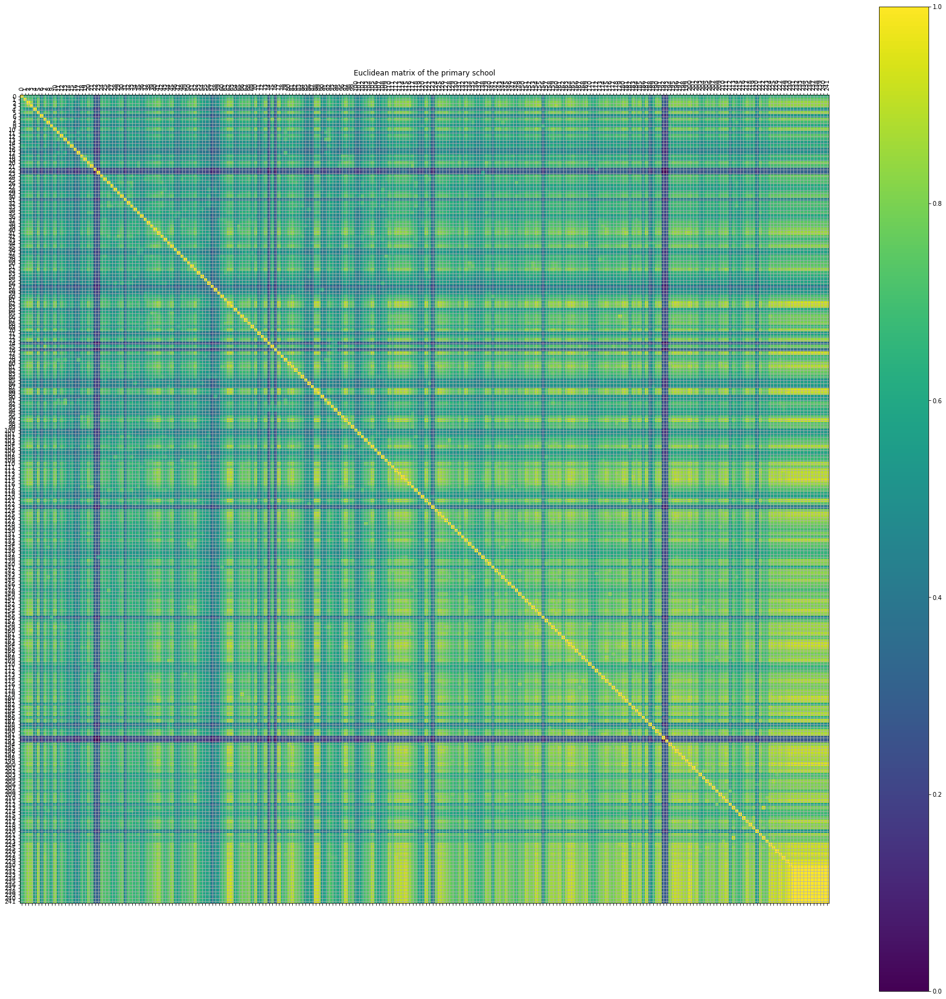

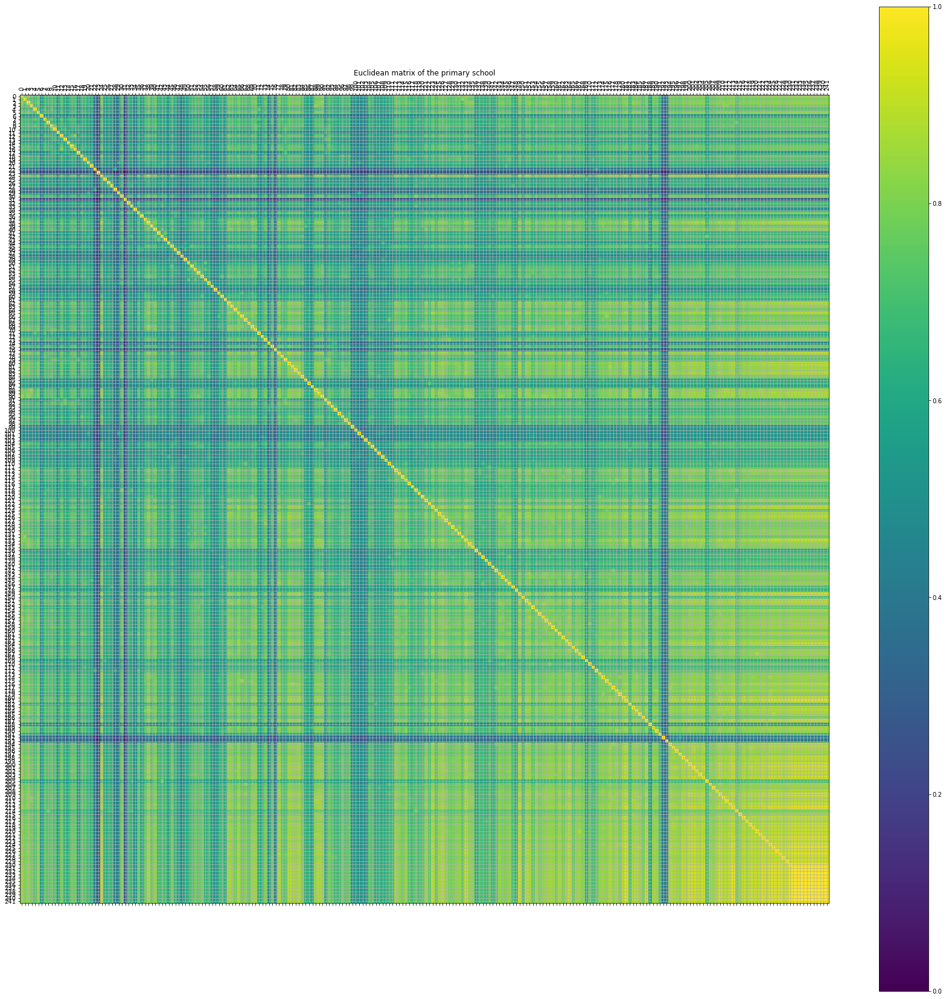

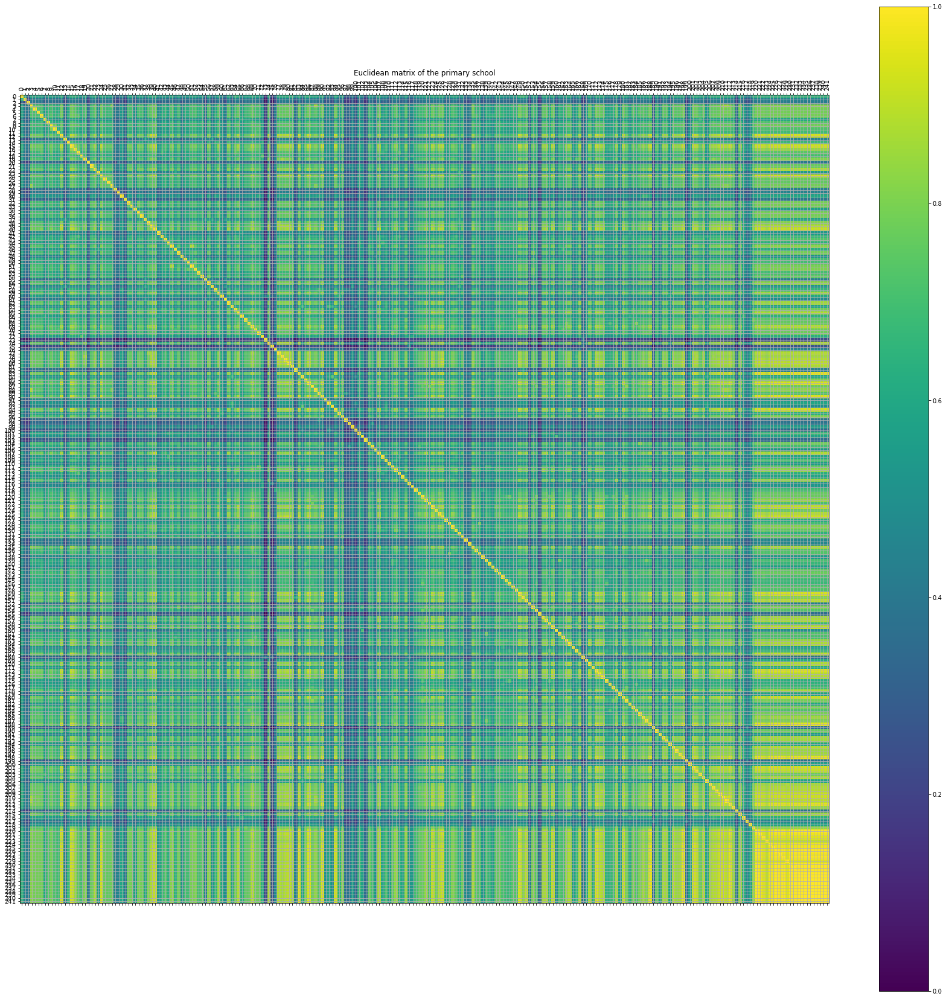

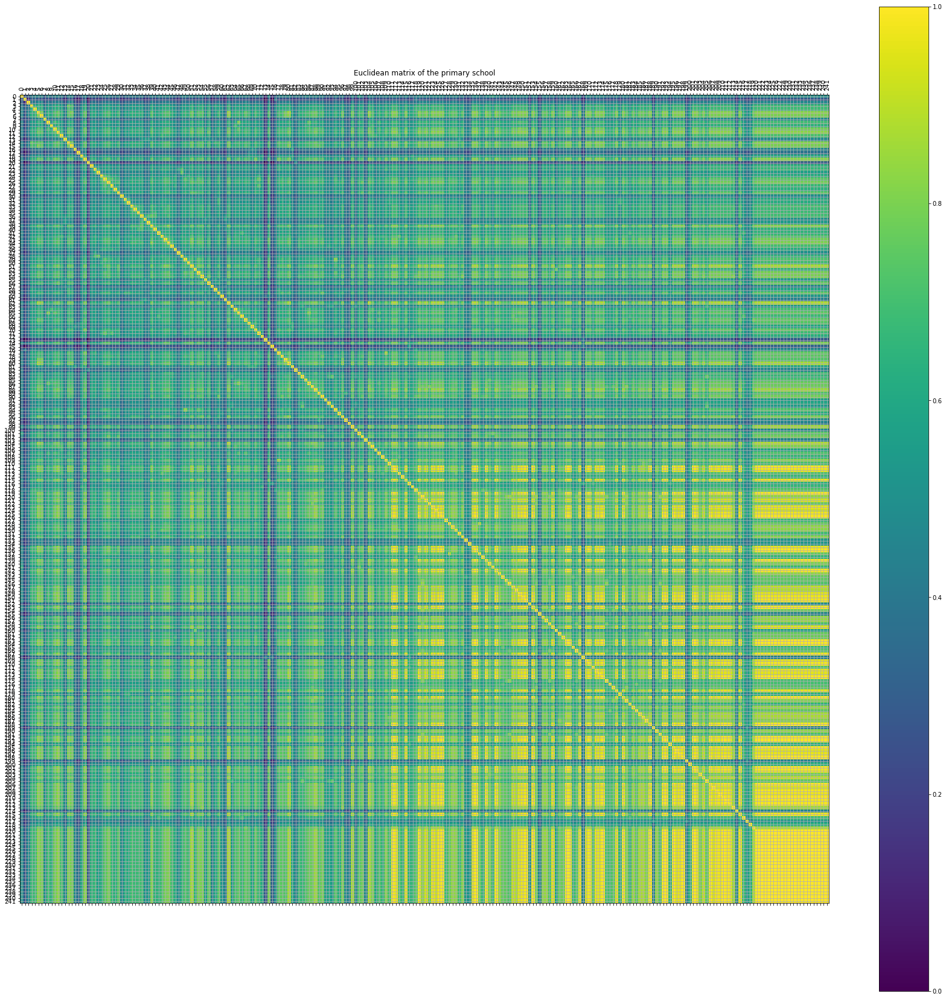

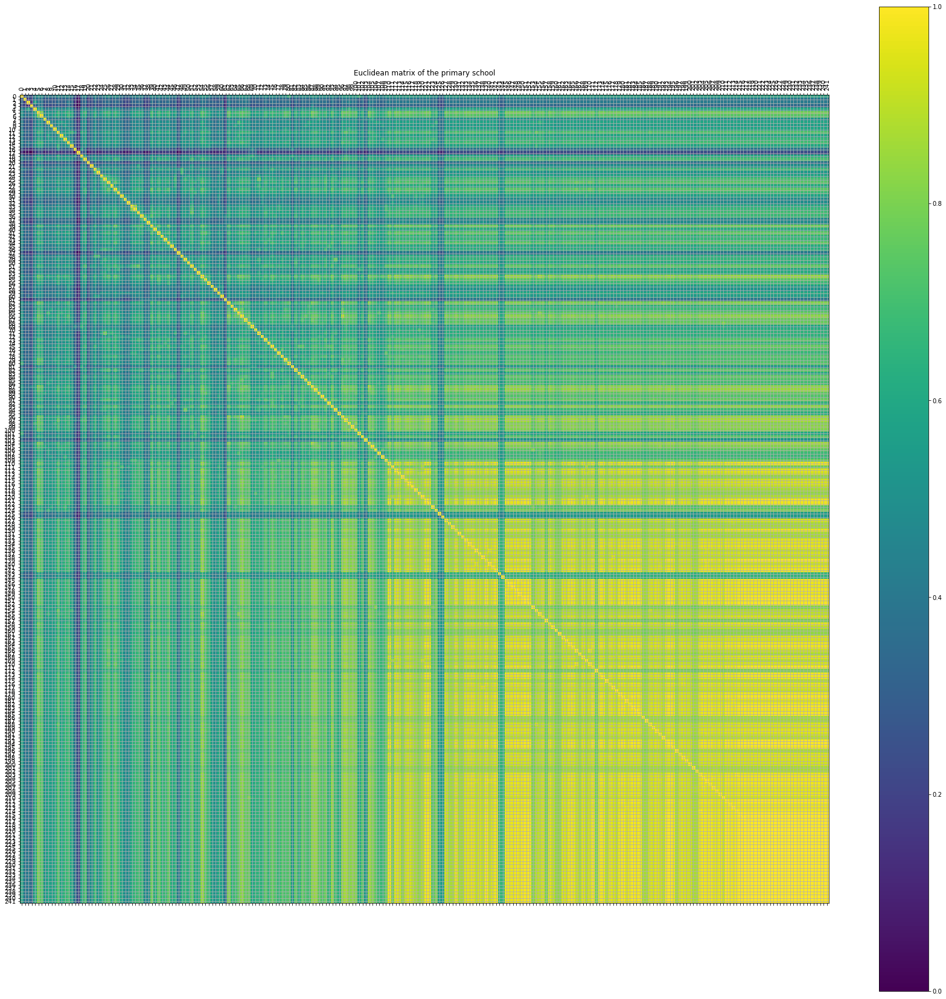

...

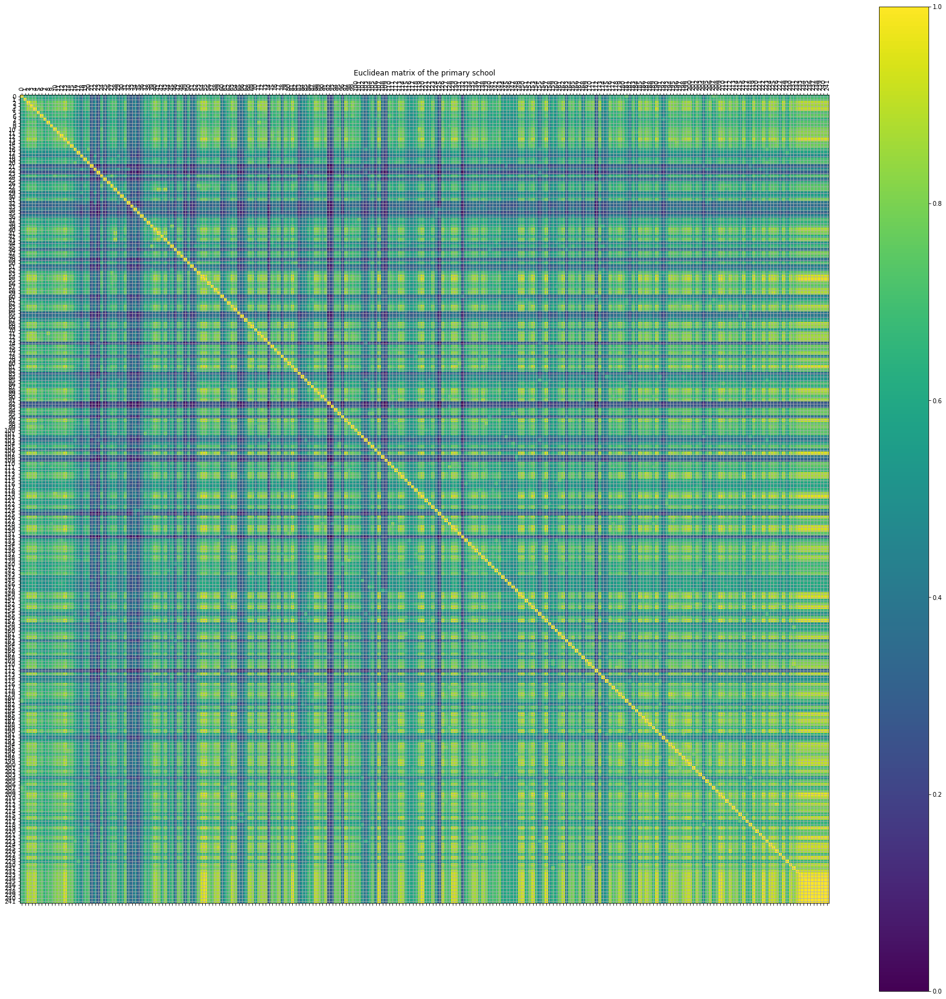

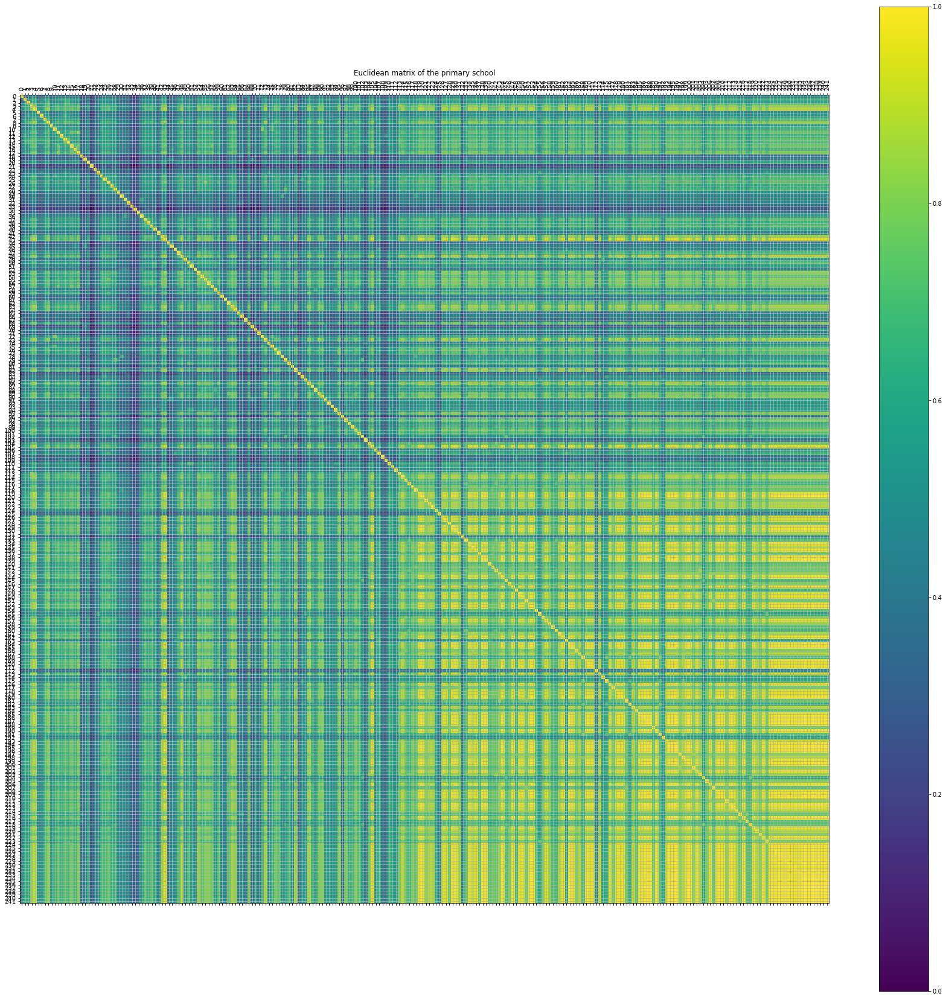

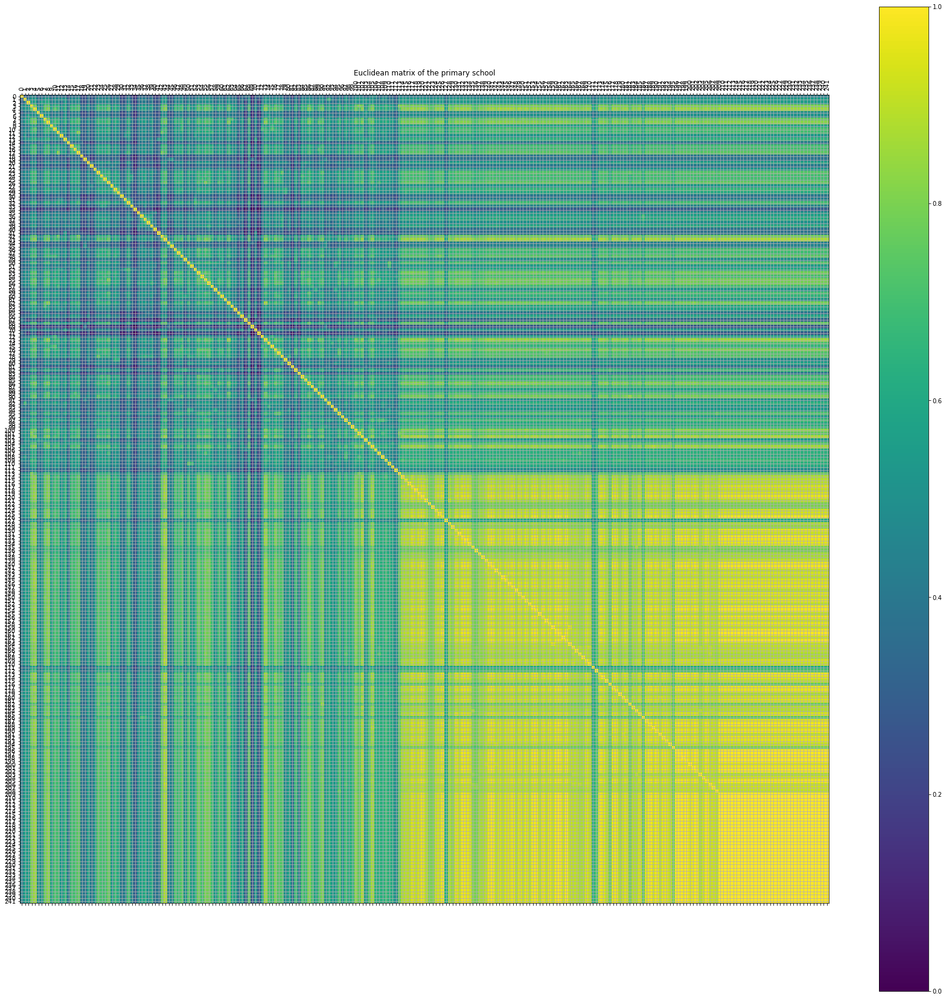

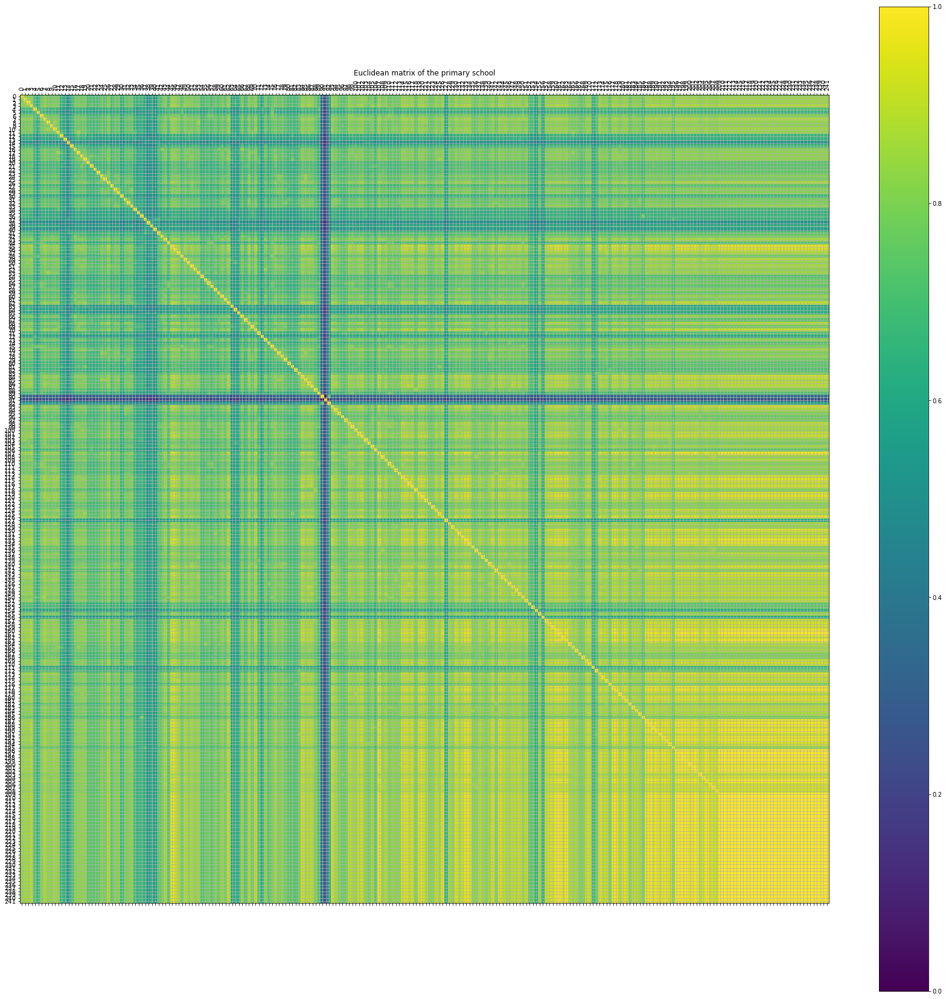

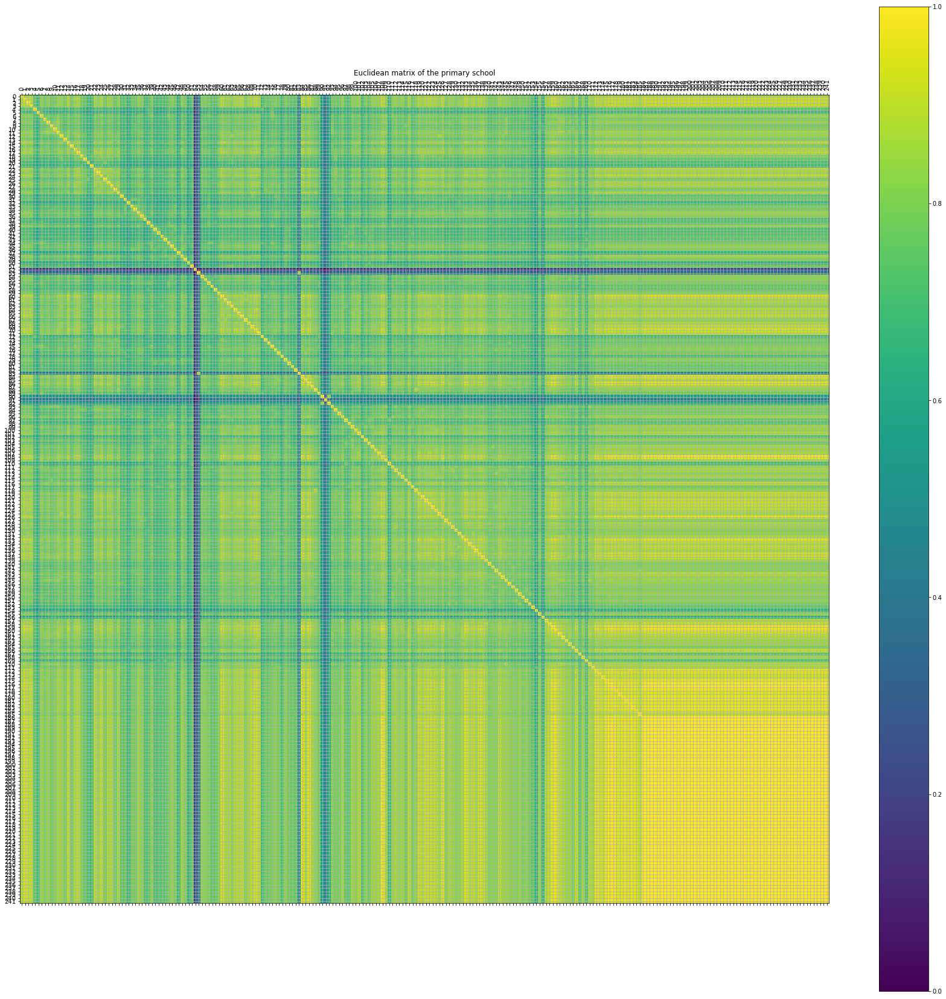

In [14]:
def main():
    csv_data = csv_data_encoder("primaryschool.csv")
    csv_data_time_converted = decrypt_csv_timestamp(csv_data)
    data_partitioned = data_partitioner(csv_data_time_converted)
    static_nets = nets(data_partitioned)
    distance_matrix = hamming_matrix_creation(static_nets)
    #euclidean_matrix = euclidean_matrix_creation(distance_matrix[0])
    #euclidean_matrix_plot(euclidean_matrix)
    for i in range(len(distance_matrix)):
        euclidean_matrix = euclidean_matrix_creation(distance_matrix[i])
        euclidean_matrix_plot(euclidean_matrix)
main()